In [94]:

import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px
from os import path
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
import matplotlib.pyplot as plt

#reading data
df=pd.read_excel("Tenders__.xlsx")
df.head()

,Tender Type,Regions,Conditionsbookletprice,Tender Status,Invitation Type,Submitiondate,Lastofferpresentationdate,Activity Name,Estimatedvalue,Invit Count,categories_count,regions_count,latest_awarding_date
0,Direct purchase,city11,0.0,completed,private,2019-12-18 13:51:58.332,2019-12-23 00:00:00,"Trade of tools, machines and devices",19444.444444,7,2,1,2020-02-13 13:18:27
1,Direct purchase,city11,0.0,completed,private,2019-12-18 13:51:58.332,2019-12-23 00:00:00,information technology,19444.444444,7,2,1,2020-02-13 13:18:27
2,Direct purchase,city11,0.0,completed,private,2019-12-22 12:53:07.624,2019-12-31 00:00:00,Insurance Activities,32777.777778,7,1,1,2020-02-13 13:12:54
3,Limited tender,city11,0.0,completed,private,2019-12-23 19:37:15.997,2019-12-26 00:00:00,"Trade of tools, machines and devices",179444.444444,5,3,1,2020-02-20 17:47:36
4,Limited tender,city11,0.0,completed,private,2019-12-23 19:37:15.997,2019-12-26 00:00:00,Trading of utensils and household appliances,179444.444444,5,3,1,2020-02-20 17:47:36


In [95]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 160732 entries, 0 to 160731
Data columns (total 13 columns):
 #   Column                     Non-Null Count   Dtype         
---  ------                     --------------   -----         
 0   Tender Type                160732 non-null  object        
 1   Regions                    160610 non-null  object        
 2   Conditionsbookletprice     152596 non-null  float64       
 3   Tender Status              160732 non-null  object        
 4   Invitation Type            152610 non-null  object        
 5   Submitiondate              159858 non-null  datetime64[ns]
 6   Lastofferpresentationdate  160731 non-null  object        
 7   Activity Name              160384 non-null  object        
 8   Estimatedvalue             152451 non-null  float64       
 9   Invit Count                160732 non-null  int64         
 10  categories_count           160732 non-null  int64         
 11  regions_count              160732 non-null  int64   

In [96]:
df.columns

Index(['Tender Type', 'Regions', 'Conditionsbookletprice', 'Tender Status',
       'Invitation Type', 'Submitiondate', 'Lastofferpresentationdate',
       'Activity Name', 'Estimatedvalue', 'Invit Count', 'categories_count',
       'regions_count', 'latest_awarding_date'],
      dtype='object')

In [97]:
df["Tender Status"].value_counts()

completed    103629
cancelled     57103
Name: Tender Status, dtype: int64

In [98]:
df.describe()

,Conditionsbookletprice,Estimatedvalue,Invit Count,categories_count,regions_count
count,1.525960e+05,1.524510e+05,160732.000000,160732.000000,160732.000000
mean,2.949742e+03,4.202829e+05,5.921210,1.468345,1.142610
std,9.647543e+05,3.987294e+06,15.998151,1.024884,1.113828
min,0.000000e+00,1.666667e+03,0.000000,0.000000,0.000000
25%,0.000000e+00,1.277778e+04,1.000000,1.000000,1.000000
50%,0.000000e+00,3.722222e+04,2.000000,1.000000,1.000000
75%,0.000000e+00,7.246111e+04,5.000000,2.000000,1.000000
max,3.764197e+08,5.183959e+08,483.000000,17.000000,13.000000


# PREDICTING TENDERS SUCCESS 
**Based on the data we have null values in:**
1. Regions
2. Conditionsbookletprice
3. Invitation Type
4. Submitiondate
5. Lastofferpresentationdate
6. Activity Name
7. Estimatedvalue
8. latest_awarding_date

In [99]:
df["Regions"].describe()

count      160610
unique       1675
top        city11
freq        53755
Name: Regions, dtype: object

# Data Cleaning
**Based on the data we have null values in:**
1. Regions : since some tenders are not linked to a specific region , we will fill null values with "No Region"
2. Conditionsbookletprice: since mot all tenders have a booklet price , we will fill nulls with 0
3. Invitation Type: since invitation is not mandatory , we will fill null values with "No Invite"
4. Submitiondate: We will drop tenders with no submission date , since it's considered a draft.
5. Lastofferpresentationdate: we will drop this field
6. Activity Name: since the number of missing values is small , we will drop the rows with no Activity Name
7. Estimatedvalue: we will fill empty estimated values with 0
8. latest_awarding_date: This column will be droped 

In [100]:
df["Regions"]=df["Regions"].fillna("No Region")

In [101]:
df["Regions"].unique()

array([' city11', ' city10- city11', ' city11- city10', ...,
       ' city11- city10- city7 - city4- city8- city9',
       ' city10- city7 - city5 - city4- city8- city6- city1- city9- city3- city11- city13- city12- city2',
       ' city10- city7 - city5 - city4- city8- city9- city3- city6- city1- city11- city2- city13- city12'],
      dtype=object)

In [102]:
#fill nulls with 0s
df["Conditionsbookletprice"]=df["Conditionsbookletprice"].fillna(0)

In [103]:
#fill nulls with No Invite'
df["Invitation Type"]=df["Invitation Type"].fillna("No Invite")

In [104]:
#fill nulls with 0s
df["Estimatedvalue"]=df["Estimatedvalue"].fillna(0)

In [105]:
#drop nulls
df.dropna(subset=["Activity Name"],inplace=True)

In [106]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 160384 entries, 0 to 160731
Data columns (total 13 columns):
 #   Column                     Non-Null Count   Dtype         
---  ------                     --------------   -----         
 0   Tender Type                160384 non-null  object        
 1   Regions                    160384 non-null  object        
 2   Conditionsbookletprice     160384 non-null  float64       
 3   Tender Status              160384 non-null  object        
 4   Invitation Type            160384 non-null  object        
 5   Submitiondate              159511 non-null  datetime64[ns]
 6   Lastofferpresentationdate  160384 non-null  object        
 7   Activity Name              160384 non-null  object        
 8   Estimatedvalue             160384 non-null  float64       
 9   Invit Count                160384 non-null  int64         
 10  categories_count           160384 non-null  int64         
 11  regions_count              160384 non-null  int64   

# Data Cleaning 2
**Regions :** some rows contain multiple regions or cities , we will cover those values to columns to capture it as a feature


In [107]:
#replace spaces 
df["Regions"]=df["Regions"].str.replace(' ','')
df["Regions"].unique()

array(['city11', 'city10-city11', 'city11-city10', ...,
       'city11-city10-city7-city4-city8-city9',
       'city10-city7-city5-city4-city8-city6-city1-city9-city3-city11-city13-city12-city2',
       'city10-city7-city5-city4-city8-city9-city3-city6-city1-city11-city2-city13-city12'],
      dtype=object)

In [108]:
#crete new columns form rows
Regions=['city11','city10','city9','city8','city7','city6','city5','city4','city3','city2','city12','city13','city1']
for r in Regions:
    df[r]=df["Regions"].str.contains(r)
    
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 160384 entries, 0 to 160731
Data columns (total 26 columns):
 #   Column                     Non-Null Count   Dtype         
---  ------                     --------------   -----         
 0   Tender Type                160384 non-null  object        
 1   Regions                    160384 non-null  object        
 2   Conditionsbookletprice     160384 non-null  float64       
 3   Tender Status              160384 non-null  object        
 4   Invitation Type            160384 non-null  object        
 5   Submitiondate              159511 non-null  datetime64[ns]
 6   Lastofferpresentationdate  160384 non-null  object        
 7   Activity Name              160384 non-null  object        
 8   Estimatedvalue             160384 non-null  float64       
 9   Invit Count                160384 non-null  int64         
 10  categories_count           160384 non-null  int64         
 11  regions_count              160384 non-null  int64   

In [109]:
#drop the column
df.drop(inplace=True,axis=1,columns=["Regions"])
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 160384 entries, 0 to 160731
Data columns (total 25 columns):
 #   Column                     Non-Null Count   Dtype         
---  ------                     --------------   -----         
 0   Tender Type                160384 non-null  object        
 1   Conditionsbookletprice     160384 non-null  float64       
 2   Tender Status              160384 non-null  object        
 3   Invitation Type            160384 non-null  object        
 4   Submitiondate              159511 non-null  datetime64[ns]
 5   Lastofferpresentationdate  160384 non-null  object        
 6   Activity Name              160384 non-null  object        
 7   Estimatedvalue             160384 non-null  float64       
 8   Invit Count                160384 non-null  int64         
 9   categories_count           160384 non-null  int64         
 10  regions_count              160384 non-null  int64         
 11  latest_awarding_date       103394 non-null  object  

In [110]:
df["Activity Name"].unique()

array(['Trade of tools, machines and devices', 'information technology',
       'Insurance Activities',
       'Trading of utensils and household appliances',
       'Trading in cars, equipment and machinery', 'luxury trade',
       ' Trading of home furniture, furnishings, curtains and carpets',
       'Trading in clothes, fabrics, perfumes, watches, cosmetics and eyeglasses',
       'textile making', 'Food Trade', 'Security and safety activities',
       'Security Consulting Activities', 'security consulting activities',
       'Engineering Consulting Activities',
       'Trading in building materials, electrical and sanitary ware',
       'Supply of electricity, gas, water, steam and air conditioning',
       'Operation, maintenance and cleaning of facilities',
       'General contracting for buildings (construction, repair, demolition, restoration)',
       'Telecommunications',
       'Publishing, printing, advertising, advertising and artistic production services',
       'Specia

In [111]:
len(df["Activity Name"].unique())

102

# Data Cleaning 3
**Activity Name :** we have more than 100 activity type on this dataset ,we will explore it more


In [112]:
#check word cloud per all tenders peer status
activity_text=" ".join(df["Activity Name"])
activity_text_completed=" ".join(df[df["Tender Status"]=="completed"]["Activity Name"])
activity_text_cancelled=" ".join(df[df["Tender Status"]=="cancelled"]["Activity Name"])

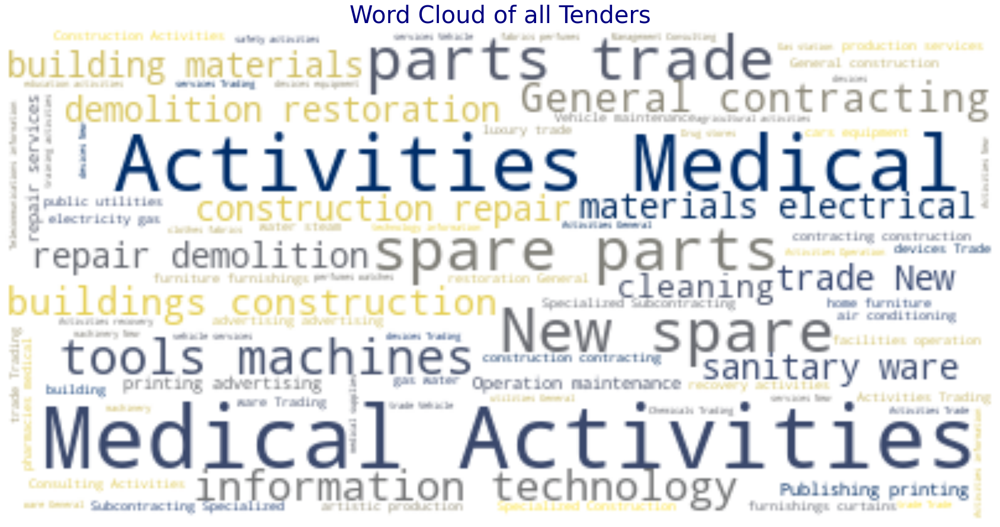

In [113]:
wordcloud = WordCloud(colormap='cividis',background_color="white").generate(activity_text)

# Display the generated image

plt.figure(figsize=(30, 30))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.title("Word Cloud of all Tenders",fontsize=40,color="navy")
plt.show()


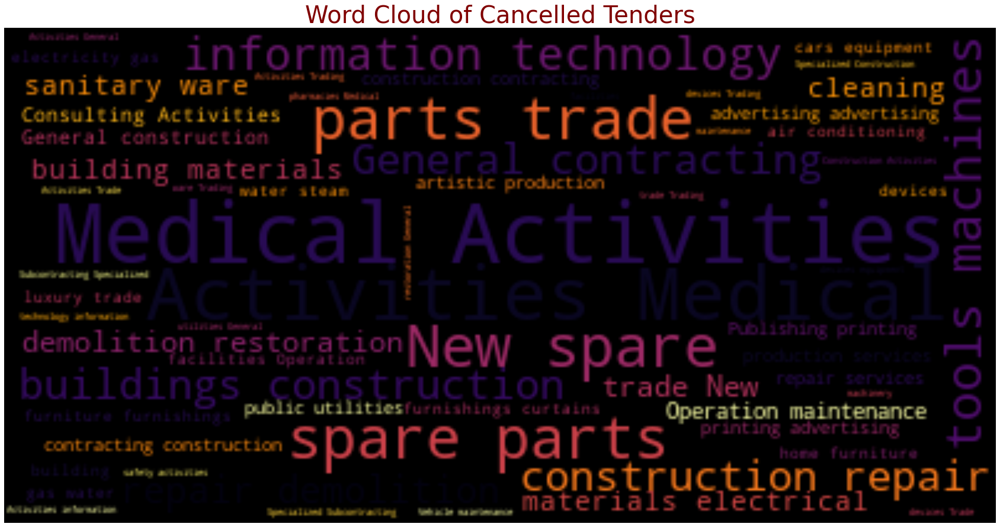

In [114]:
wordcloud = WordCloud(colormap="inferno").generate(activity_text_cancelled)

# Display the generated image:
plt.figure(figsize=(30, 30))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.title("Word Cloud of Cancelled Tenders",fontsize=40,color="maroon")
plt.show()

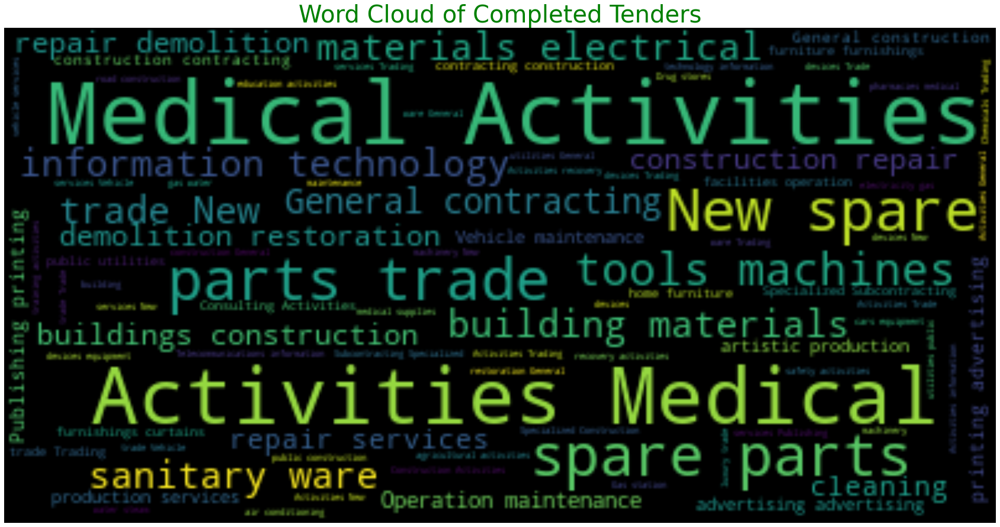

In [115]:
wordcloud = WordCloud(colormap="viridis").generate(activity_text_completed)

# Display the generated image:
plt.figure(figsize=(30, 30))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title("Word Cloud of Completed Tenders",fontsize=40,color="Green")
plt.axis("off")
plt.show()

# Exploring Activity Name
**As shown in wordclouds for all tenders, completed tenders & cancelled tenders , we can see almost the same words are repeated and not assiossiated with a class therefore this field will be dropped** 

# Data Cleaning 4
**All the dates will be dropped** 

In [116]:
#df.drop(axis=1,columns=["Submitiondate","Lastofferpresentationdate","Activity Name","latest_awarding_date"], inplace=True)
df.drop(axis=1,columns=["Submitiondate","Lastofferpresentationdate","latest_awarding_date"], inplace=True)

df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 160384 entries, 0 to 160731
Data columns (total 22 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   Tender Type             160384 non-null  object 
 1   Conditionsbookletprice  160384 non-null  float64
 2   Tender Status           160384 non-null  object 
 3   Invitation Type         160384 non-null  object 
 4   Activity Name           160384 non-null  object 
 5   Estimatedvalue          160384 non-null  float64
 6   Invit Count             160384 non-null  int64  
 7   categories_count        160384 non-null  int64  
 8   regions_count           160384 non-null  int64  
 9   city11                  160384 non-null  bool   
 10  city10                  160384 non-null  bool   
 11  city9                   160384 non-null  bool   
 12  city8                   160384 non-null  bool   
 13  city7                   160384 non-null  bool   
 14  city6               

# Data Processing
**The categorical columns will be converted to columns using one-hot encoding** 
1. Invitation Type
2. Tender Type
3. Tender Status

In [117]:
df["Invitation Type"].value_counts()

private      91916
public       60346
No Invite     8122
Name: Invitation Type, dtype: int64

In [118]:
#create dummies
df=pd.get_dummies(df,columns=["Invitation Type"], prefix='Invitation_Type',drop_first=True)
df=pd.get_dummies(df,columns=["Activity Name"], prefix='Activity_Name_')
df.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 160384 entries, 0 to 160731
Columns: 124 entries, Tender Type to Activity_Name__wear making
dtypes: bool(13), float64(2), int64(3), object(2), uint8(104)
memory usage: 27.7+ MB


In [119]:
df.columns

Index(['Tender Type', 'Conditionsbookletprice', 'Tender Status',
       'Estimatedvalue', 'Invit Count', 'categories_count', 'regions_count',
       'city11', 'city10', 'city9',
       ...
       'Activity_Name__recovery activities', 'Activity_Name__recruitment',
       'Activity_Name__security consulting activities',
       'Activity_Name__social services', 'Activity_Name__textile making',
       'Activity_Name__the hunt', 'Activity_Name__tourism activities',
       'Activity_Name__training activities',
       'Activity_Name__veterinary activities', 'Activity_Name__wear making'],
      dtype='object', length=124)

# Exploratory Data Analysis(EDA)
**Tender Type :**
### looking at the plots we can notice:
1. Highest proption of tender are direct purchases
2. Most post qualification tenders are cancelled
3. We can see high cancllation rates in general & limited tenders

Text(0.5, 1.0, 'Tender Type Distribution')

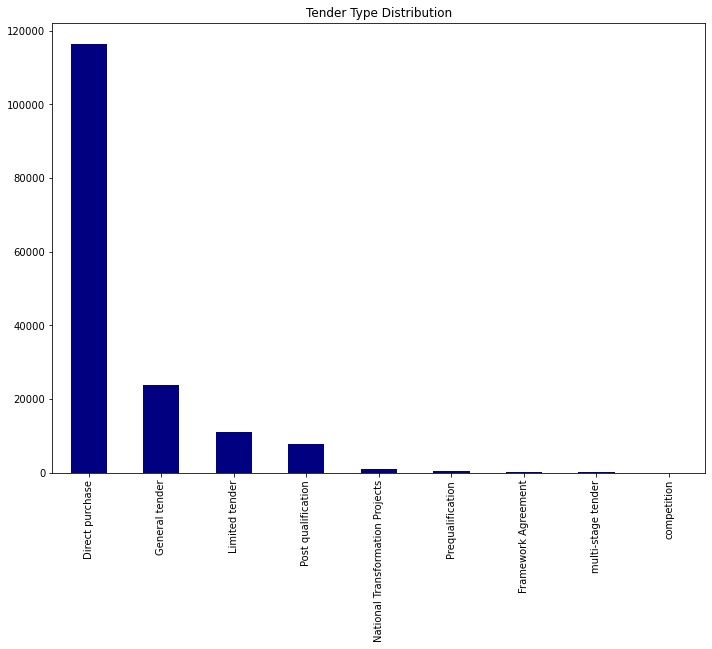

In [120]:

fig, ax = plt.subplots()
fig.set_size_inches(11.7, 8.27)
plt.xticks(rotation=45)
df['Tender Type'].value_counts().plot.bar(color="navy")
plt.title("Tender Type Distribution")
#.hist(figsize=(10,10));

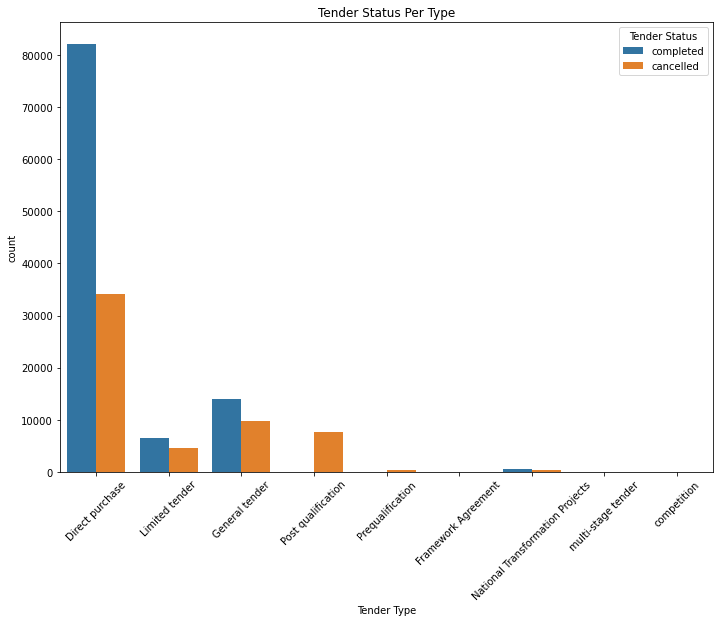

In [121]:

fig, ax = plt.subplots()
fig.set_size_inches(11.7, 8.27)
plt.xticks(rotation=45)
plt.title("Tender Status Per Type")
ax.set(xlabel='Tender Type', ylabel='Count')
ax = sns.countplot(x="Tender Type", hue="Tender Status", data=df)



**Conditionsbookletprice :**
### looking at the plots we can notice:
1. Most of tenders have no Conditions booklet price
2. The values are far away 
3. Looking at tenders with Conditions booklet price higher than 100K SAR, most of them are cancelled
4. Tenders with booklet price between 1-100 SAR , the odds are equal based on the data for completion or cancellation
5. Tenders with no Conditions booklet price have more propability of being completed based on the data

In [122]:
fig = px.histogram(df, x='Conditionsbookletprice',color="Tender Status",nbins=70,title="Conditions Booklet Price Distribution")
fig.show()

In [123]:
df_high_Conditionsbookletprice=df[(df['Conditionsbookletprice']>100) & (df['Conditionsbookletprice']<100000)]
fig = px.histogram(df_high_Conditionsbookletprice, x='Conditionsbookletprice',color="Tender Status",nbins=70,title="Conditions Booklet Price with values 100-100K SAR")
fig.show()

In [124]:
df_very_high_Conditionsbookletprice=df[(df['Conditionsbookletprice']>100000) & (df['Conditionsbookletprice']<1000000)]
fig = px.histogram(df_very_high_Conditionsbookletprice, x='Conditionsbookletprice',color="Tender Status",nbins=70,title="Conditions Booklet Price with values 100K-1M SAR")
fig.show()

In [125]:
df_low_Conditionsbookletprice=df[(df['Conditionsbookletprice']>0) & (df['Conditionsbookletprice']<100)]
fig = px.histogram(df_low_Conditionsbookletprice, x='Conditionsbookletprice',color="Tender Status",nbins=70,title="Conditions Booklet Price with values 1-100 SAR")
fig.show()

In [126]:
df_very_low_Conditionsbookletprice=df[(df['Conditionsbookletprice']==0) ]
fig = px.histogram(df_very_low_Conditionsbookletprice, x='Conditionsbookletprice',color="Tender Status",nbins=1,title="Tenders With No Conditions Booklet Price")
fig.show()


**Invit Count:**
### looking at the plots we can notice:
1. Most of tenders have no Invitations
2. Looking at tenders with Invitations higher than 50,we can see more tenders are cancelled
4. Tenders with booklet price between 1-100 SAR , the odds are equal based on the data for completion or cancellation
5. Tenders with no Conditions booklet price have more propability of being completed based on the data

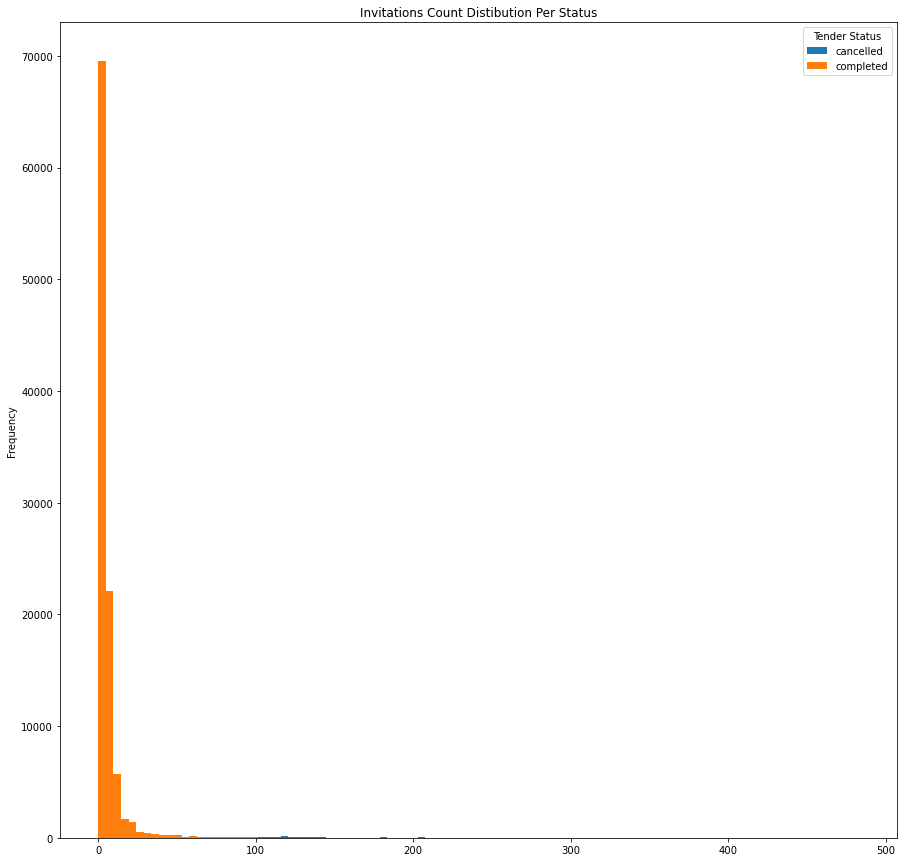

In [127]:

df.pivot(columns="Tender Status", values="Invit Count").plot.hist(bins=100,figsize = (15,15),title="Invitations Count Distibution Per Status")

plt.show()

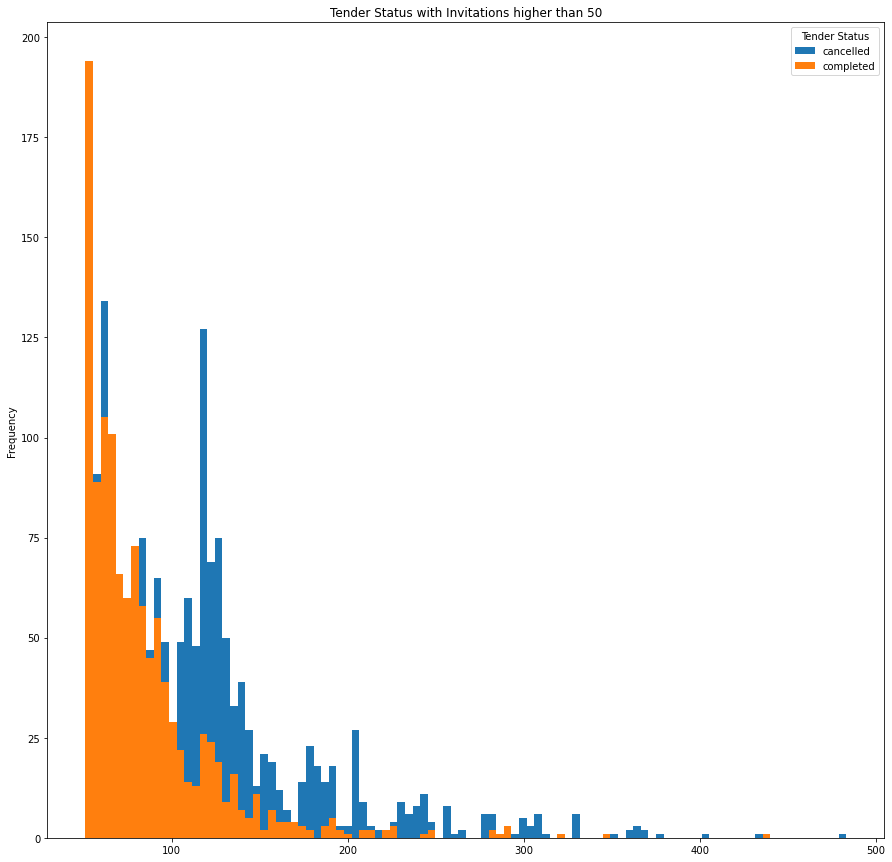

In [128]:

df_high_Invit=df[(df['Invit Count']>50) ]
df_high_Invit.pivot(columns="Tender Status", values="Invit Count").plot.hist(bins=100,figsize = (15,15),title="Tender Status with Invitations higher than 50")

plt.show()

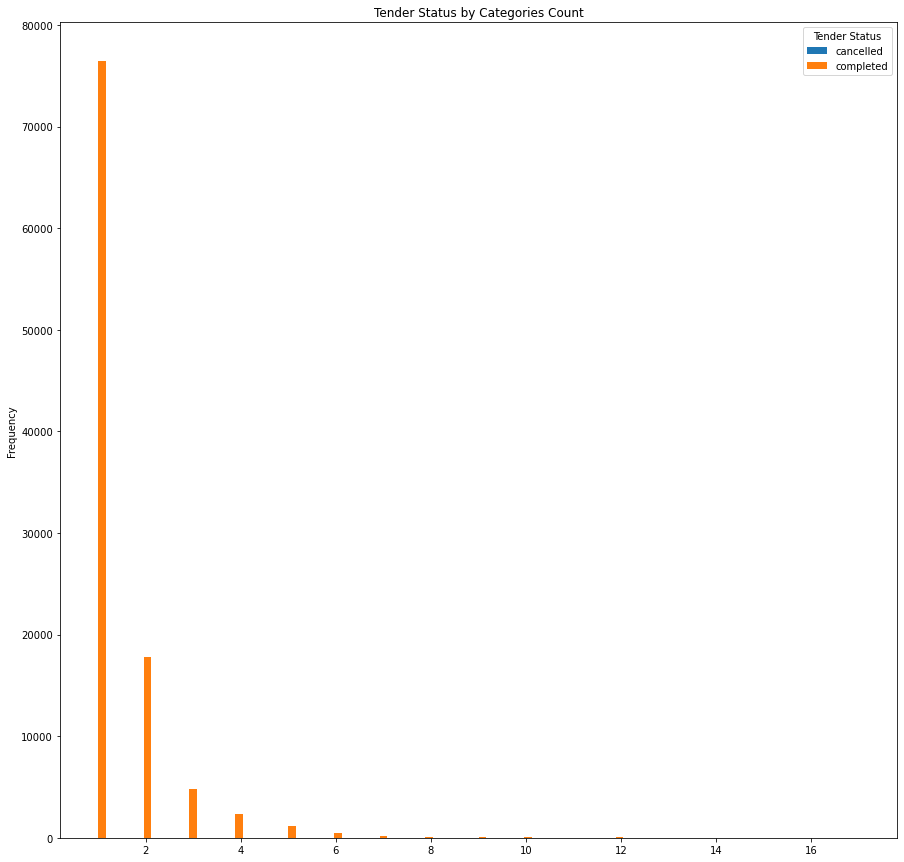

In [129]:
df.pivot(columns="Tender Status", values="categories_count").plot.hist(bins=100,figsize = (15,15),title="Tender Status by Categories Count")

plt.show()

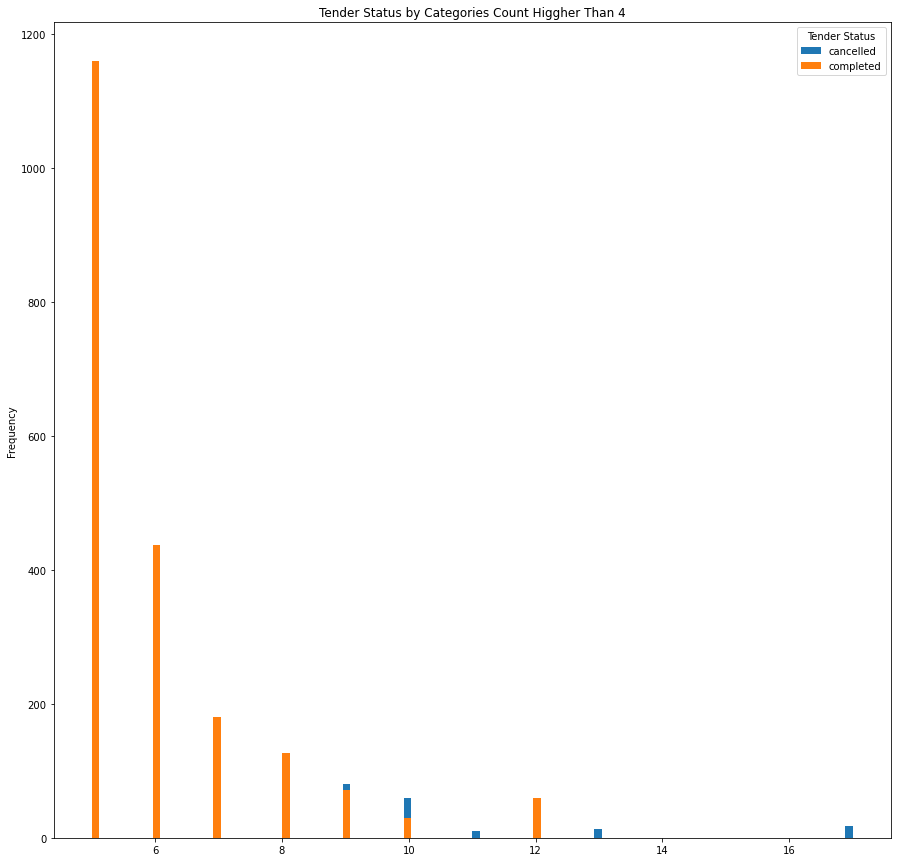

In [130]:
df_high_cat=df[(df['categories_count']>4) ]
df_high_cat.pivot(columns="Tender Status", values="categories_count").plot.hist(bins=100,figsize = (15,15),title="Tender Status by Categories Count Higgher Than 4")

plt.show()

In [131]:

fig = px.histogram(df, x='Estimatedvalue',color="Tender Status",nbins=70,title="Estimated Value Distribution")
fig.show()

In [132]:
fig = px.histogram(df[df["Estimatedvalue"]==0], x='Estimatedvalue',color="Tender Status",nbins=70,title="Estimated Value=0 Distribution")
fig.show()

In [138]:
df_1000=df[(df["Estimatedvalue"]>0) & (df["Estimatedvalue"]<10000)]
fig = px.histogram(df_1000, x='Estimatedvalue',color="Tender Status",nbins=70,title="Estimated Value between 1-10k Distribution")
fig.show()

In [140]:
df_10000=df[(df["Estimatedvalue"]>10000) & (df["Estimatedvalue"]<1000000)]
fig = px.histogram(df_10000, x='Estimatedvalue',color="Tender Status",nbins=70,title="Estimated Value between 10k-1m Distribution")
fig.show()

In [141]:
df_m=df[(df["Estimatedvalue"]>1000000)]
fig = px.histogram(df_m, x='Estimatedvalue',color="Tender Status",nbins=70,title="Estimated Value >1m Distribution")
fig.show()

In [86]:

def get_invitations_group_status(inv_count):
    if inv_count==0:
        return "no_invitations"
    elif inv_count>0 and inv_count<50:
        return "invitations_less_50"
    elif inv_count>50 and inv_count<100:
        return "invitations_bet_50_100"
    elif inv_count>100 and inv_count<150:
        return "invitations_bet_100_150"
    elif inv_count>150 and inv_count<200:
         return "invitations_bet_150_200"
    else:
        return "invitations_more_200"
df["invitations_group"]=df["Invit Count"].apply(get_invitations_group_status)
df["invitations_group"].value_counts()

invitations_less_50        123395
no_invitations              33975
invitations_bet_50_100       1730
invitations_bet_100_150       773
invitations_more_200          319
invitations_bet_150_200       192
Name: invitations_group, dtype: int64

In [87]:

def get_Conditionsbookletprice_group_status(price):
    if price==0:
        return "no_bookletprice"
    elif price>0 and price<100:
        return "bookletprice_less_100"
    elif price>100 and price<100000:
        return "bookletprice_bet_100_100k"
    else:
        return "bookletprice_more_100k"
df["booklet_price_group"]=df["Conditionsbookletprice"].apply(get_Conditionsbookletprice_group_status)
df["booklet_price_group"].value_counts()

no_bookletprice              134079
bookletprice_bet_100_100k     24661
bookletprice_more_100k         1471
bookletprice_less_100           173
Name: booklet_price_group, dtype: int64

In [88]:

def get_Estimatedvalue_status(Estimatedvalue):
    if Estimatedvalue==0:
        return "no_Estimatedvalue"
    elif Estimatedvalue<100000:
        return "Estimatedvalue_less_100k"
    elif Estimatedvalue>100000 and Estimatedvalue<1000000:
        return "Estimatedvalue_bet_100k_1m"
    elif Estimatedvalue>1000000 and Estimatedvalue<10000000:
        return "Estimatedvalue_bet_1m_10m"
    else:
        return "Estimatedvalue_more_10m"
df["Estimatedvalue_group"]=df["Estimatedvalue"].apply(get_Estimatedvalue_status)
df["Estimatedvalue_group"].value_counts()

Estimatedvalue_less_100k      118625
Estimatedvalue_bet_100k_1m     23701
Estimatedvalue_bet_1m_10m       8855
no_Estimatedvalue               8281
Estimatedvalue_more_10m          922
Name: Estimatedvalue_group, dtype: int64

In [89]:
df.columns

Index(['Tender Type', 'Conditionsbookletprice', 'Tender Status',
       'Estimatedvalue', 'Invit Count', 'categories_count', 'regions_count',
       'city11', 'city10', 'city9',
       ...
       'Activity_Name__social services', 'Activity_Name__textile making',
       'Activity_Name__the hunt', 'Activity_Name__tourism activities',
       'Activity_Name__training activities',
       'Activity_Name__veterinary activities', 'Activity_Name__wear making',
       'invitations_group', 'booklet_price_group', 'Estimatedvalue_group'],
      dtype='object', length=127)

In [90]:
df.drop(inplace=True,axis=1,columns=["Estimatedvalue","Conditionsbookletprice","Invit Count"])


In [91]:
df=pd.get_dummies(df,columns=["Estimatedvalue_group","booklet_price_group","invitations_group"])
df.columns

Index(['Tender Type', 'Tender Status', 'categories_count', 'regions_count',
       'city11', 'city10', 'city9', 'city8', 'city7', 'city6',
       ...
       'booklet_price_group_bookletprice_bet_100_100k',
       'booklet_price_group_bookletprice_less_100',
       'booklet_price_group_bookletprice_more_100k',
       'booklet_price_group_no_bookletprice',
       'invitations_group_invitations_bet_100_150',
       'invitations_group_invitations_bet_150_200',
       'invitations_group_invitations_bet_50_100',
       'invitations_group_invitations_less_50',
       'invitations_group_invitations_more_200',
       'invitations_group_no_invitations'],
      dtype='object', length=136)

In [92]:
(df.columns)

Index(['Tender Type', 'Tender Status', 'categories_count', 'regions_count',
       'city11', 'city10', 'city9', 'city8', 'city7', 'city6',
       ...
       'booklet_price_group_bookletprice_bet_100_100k',
       'booklet_price_group_bookletprice_less_100',
       'booklet_price_group_bookletprice_more_100k',
       'booklet_price_group_no_bookletprice',
       'invitations_group_invitations_bet_100_150',
       'invitations_group_invitations_bet_150_200',
       'invitations_group_invitations_bet_50_100',
       'invitations_group_invitations_less_50',
       'invitations_group_invitations_more_200',
       'invitations_group_no_invitations'],
      dtype='object', length=136)